# Intro
This notebook builds a baseline model using the U-Net model architecture and an in-house labeled dataset. This notebook does not involve transfer learning, but it uses augmentation.

## Installing packages

In [1]:
!pip install -q ipython-autotime
!pip install -q timm
!pip install -q git+https://github.com/qubvel/segmentation_models.pytorch

%load_ext autotime

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
time: 562 µs (started: 2023-07-01 12:36:42 +00:00)


## Importing Libraries

In [2]:
import torch
import torch.nn as nn
import os
import time
from torch.utils.data import Dataset, DataLoader
from os.path import isfile, join
from osgeo import gdal
import numpy as np
import pandas as pd
from timm.scheduler.cosine_lr import CosineLRScheduler
from tqdm.notebook import tqdm
from torch.utils.tensorboard import SummaryWriter
from torch.optim import Adam, AdamW
from torch.cuda.amp import autocast, GradScaler
import matplotlib.pyplot as plt
import albumentations as A
from albumentations.pytorch import ToTensorV2
from albumentations import ImageOnlyTransform
import random
import shutil
from sklearn.metrics import jaccard_score, f1_score
import cv2 as cv
import segmentation_models_pytorch as smp
from torchvision.utils import make_grid
from google.colab import drive

time: 19.6 s (started: 2023-07-01 12:36:42 +00:00)


## Setup
Here we connect to a Google Drive and set up a TensorFlow events recorder to later use for metrics visualizations using TensorBoard.

In [3]:
# Removing old logs
!rm -rf /data/runs

drive.mount('/content/drive')
writer = SummaryWriter("/data/runs")

%load_ext tensorboard

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
time: 1.37 s (started: 2023-07-01 12:37:01 +00:00)


# Loading Dataset
Downloading in-house labeled dataset from a Google Drive to a local disk that will be directly used for model training.

In [4]:
# What is the dataset image dimention?
img_size = 256
# Remote directory on a Google Drive
remote_dataset_dir = f"/content/drive/MyDrive/GEE_Boreal_clean_rect_{img_size}/"
# Local directory where the data will be downloaded to
dataset_dir = f"/content/data_{img_size}/"

# Download the dataset if it is not done yet
if not os.path.isdir(dataset_dir):
    # Dowloading the dataset
    !mkdir {dataset_dir}
    !cp -nr {remote_dataset_dir}image {dataset_dir}
    !cp -nr {remote_dataset_dir}mask {dataset_dir}
    !du -h -d 1 {dataset_dir}

time: 913 µs (started: 2023-07-01 12:37:03 +00:00)


# Augmentation

We applied different types of augmentations, including brightness, contrast, flips, blurring, noise, zooming, and grid shuffling. The object is to increase the dataset size, and make the model learn the underlying pattern to generalize better.

In [5]:
p = 0.5
def trntransforms():
    return A.Compose([
        A.RandomBrightnessContrast(brightness_limit=(-.02, .01), contrast_limit=(-.1, .2), p=1.0),
        A.HorizontalFlip(p=p),
        A.VerticalFlip(p=p),
        A.Transpose(p=p),
        A.Rotate(p=.75),
        A.Compose([
          A.RandomScale(scale_limit=[0., .5], p=1.0),
          A.RandomCrop(width=img_size, height=img_size, p=1.0),
        ], p=1.0),
        A.OneOf([
          A.GaussNoise(var_limit=(0.00001, 0.000001), p=.25),
          A.GaussianBlur(blur_limit=(3, 7), p=.25),
          A.MotionBlur(blur_limit=3, p=.25),
          A.MedianBlur(blur_limit=5, p=.25),
        ], p=1.0),
        A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, p=1.),
        A.RandomGridShuffle(grid=(3, 3), p=.99),
    ], additional_targets={'image0': 'image', 'mask0': 'mask'})

def tsttransforms():
    return A.Compose([])

time: 1.21 ms (started: 2023-07-01 12:37:03 +00:00)


# Dataset Split

Here we split the dataset to 80/20 for training and validation.

In [6]:
# Set the random seed for reproducibility
random_seed = 73
random.seed(random_seed)

# Set the source directory path
image_source_directory = f"{dataset_dir}image/"
mask_source_directory = f"{dataset_dir}mask/"

# Set the destination directories for the split
train_image_directory = f"{dataset_dir}train/image/"
train_mask_directory = f"{dataset_dir}train/mask/"
valid_image_directory = f"{dataset_dir}valid/image/"
valid_mask_directory = f"{dataset_dir}valid/mask/"

# Split the dataset if it is not done yet
if not os.path.isdir(train_image_directory):
    !mkdir -p {train_image_directory}
    !mkdir -p {train_mask_directory}
    !mkdir -p {valid_image_directory}
    !mkdir -p {valid_mask_directory}

    # Set the train/test split ratio
    split_ratio = 0.80

    # Get the list of files in the source directory
    data_files = []
    for file_name in os.listdir(image_source_directory):
        if isfile(join(image_source_directory, file_name)) and isfile(join(mask_source_directory, file_name)) and '.tif' in file_name:
            data_files.append(file_name)

    # Randomly shuffle the directories
    data_files.sort()
    random.shuffle(data_files) # Use the same seed

    # Split the directories
    split_index = int(split_ratio * len(data_files))
    train_files = data_files[:split_index]
    test_files = data_files[split_index:]
    print("Train size = ", len(train_files))
    print("Valid size = ", len(test_files))

    # Move directories to train directory
    for f in train_files:
        source_path = os.path.join(image_source_directory, f)
        destination_path = os.path.join(train_image_directory, f)
        shutil.copy(source_path, destination_path)
        source_path = os.path.join(mask_source_directory, f)
        destination_path = os.path.join(train_mask_directory, f)
        shutil.copy(source_path, destination_path)

    # Move directories to test directory
    for f in test_files:
        source_path = os.path.join(image_source_directory, f)
        destination_path = os.path.join(valid_image_directory, f)
        shutil.copy(source_path, destination_path)
        source_path = os.path.join(mask_source_directory, f)
        destination_path = os.path.join(valid_mask_directory, f)
        shutil.copy(source_path, destination_path)
    print()

time: 1.82 ms (started: 2023-07-01 12:37:03 +00:00)


# Dataset
Defining a custom dataset that loads and generates the data after applying augmentations and transformations.

In [7]:
# loadTiff used to read the raster data and you clip and normalize it for display purpose
def loadTiff(in_image, max_val=-1, clip_max=1.0):
    src = gdal.Open(in_image)
    in_band = src.GetRasterBand(1)
    block_xsize, block_ysize = (in_band.XSize, in_band.YSize)
    # read the (multiband) file into an array
    image = src.ReadAsArray(0, 0, block_xsize, block_ysize)
    # Trigger this section for display purpose only
    if max_val != -1:
        nan_count = np.count_nonzero(np.isnan(image))
        if nan_count > 0:
            image = np.nan_to_num(image, nan=0.0)
        for i in range(src.RasterCount):
            image[i] = np.clip(image[i]/max_val, 0, clip_max)
        # reshape from bandsxheightxwidth to wxhxb
        image = np.moveaxis(image, 0, -1)
    return image, block_ysize, block_xsize, src.RasterCount

time: 948 µs (started: 2023-07-01 12:37:03 +00:00)


In [8]:
class ScarsDataset(Dataset):
    """Scars Dataset."""

    def __init__(self, data_dir, data_type="train", transform=None, ratio=1.0, clip_max=10000):
        """Initializing data generator class object"""

        self.transform = transform
        self.mean = np.array([])
        self.SD = np.array([])
        self.clip_max = clip_max
        self.mean = np.array([0.040142175, 0.04693995, 0.032072444, 0.1858127], dtype='float32')
        self.SD = np.array([0.01378011, 0.0109268455, 0.007526047, 0.0477632], dtype='float32')

        data_files = []
        image_dir = data_dir+data_type+"/image/"
        mask_dir = data_dir+data_type+"/mask/"
        for file_name in os.listdir(image_dir):
            if isfile(join(image_dir, file_name)) and isfile(join(mask_dir, file_name)) and '.tif' in file_name:
                data_files.append([join(image_dir, file_name), join(mask_dir, file_name)])

        # Taking files based on the ratio. Useful for rapid prototype work
        data_files.sort()
        total_files = len(data_files)
        if ratio < 1.0:
            files_to_take = round(len(data_files)*ratio)
            # Making sure there is a minumum of one files
            if files_to_take <= 0:
                files_to_take = 1
            data_files = data_files[:files_to_take]

        bands_data = []
        mask_sum_acc, size_sum = 0.0, 0
        for f in data_files:
            [mask, m_xsize, m_ysize, m_nbands] = loadTiff(f[1])
            mask_sum = mask.sum()
            # Ignore the data if it does not has assocaiated labels
            if mask_sum <= 0:
                continue
            [img, xsize, ysize, nbands] = loadTiff(f[0])
            mask = mask.astype('float32')
            img = img.astype(np.float32)
            img = np.transpose(img, axes=[1, 2, 0])
            # There is a once case where the image has some nan values. We are replacing it with 0 values
            nan_count = np.count_nonzero(np.isnan(img))
            if nan_count > 0:
                print(f'{f[0]} file has {nan_count} NaN values.')
                img = np.nan_to_num(img, nan=0.0)
            # Clip to the given max size
            img = np.clip(img, 0, self.clip_max)
            # Normalization
            img = img/np.array([self.clip_max]*4)
            img = np.transpose(img, axes=[2, 0, 1]).astype(np.float32)

            width = mask.shape[0]
            height = mask.shape[1]
            mask = mask.flatten()
            mask_sum_acc += mask_sum
            size_sum += np.size(mask)

            band_dict = {
                'image_path': f[0],
                'mask_path': f[1],
                'red': img[0].flatten(),
                'green': img[1].flatten(),
                'blue': img[2].flatten(),
                'nir': img[3].flatten(),
                'mask': mask, # y
                'mask_sum': mask_sum,
                'width': width,
                'height': height,
            }
            bands_data.append(band_dict)

        self.data = pd.DataFrame(bands_data)
        # 1.25 gives the minority class a boost since there sections in the image which are not labeled
        #self.pos_weight = ((size_sum-mask_sum_acc) / mask_sum_acc) #*1.1
        pos_sum = mask_sum_acc + mask_sum_acc*0
        self.pos_weight = ((size_sum-pos_sum) / size_sum)

        # Mean and SD for standardization
        if self.mean.size == None or self.SD.size == 0:
            mean, std_dev = {}, {}
            mean["red"] = np.mean(np.concatenate(self.data['red'])).astype('float32')
            mean["green"] = np.mean(np.concatenate(self.data['green'])).astype('float32')
            mean["blue"] = np.mean(np.concatenate(self.data['blue'])).astype('float32')
            mean["nir"] = np.mean(np.concatenate(self.data['nir'])).astype('float32')
            std_dev["red"] = np.std(np.concatenate(self.data['red'])).astype('float32')
            std_dev["green"] = np.std(np.concatenate(self.data['green'])).astype('float32')
            std_dev["blue"] = np.std(np.concatenate(self.data['blue'])).astype('float32')
            std_dev["nir"] = np.std(np.concatenate(self.data['nir'])).astype('float32')
            self.mean = mean
            self.SD = std_dev
            print(mean)
            print(std_dev)

        print(f'Taking {self.data.shape[0]:,}/{total_files:,} data files.')

    def __len__(self):
        return self.data.shape[0]

    def __getitem__(self, idx):
        """Returns back a data"""

        row = self.data.iloc[idx]
        vals = []
        for ch in ['red', 'green', 'blue', 'nir']:
            v = row[ch].reshape(row['width'], row['height'])
            vals.append(v)
        original_x = vals
        original_x = np.clip(original_x, 0.0, 0.2)
        original_x = (original_x - np.min(original_x)) / (np.max(original_x) - np.min(original_x))
        x = np.stack(vals, axis=-1) # -1 to move the channel at the end

        y = row['mask']
        y = y.reshape(row['width'], row['height'])
        y = np.dstack((y, y, y))
        if self.transform is not None: # If there is no transformation
            transformed = self.transform(image=x, mask=y)
            y = torch.from_numpy(transformed["mask"][:,:,0]).unsqueeze(0)
            x = transformed["image"]
            x = (x - self.mean) / self.SD
            x = torch.from_numpy(np.transpose(x.astype(np.float32), axes=[2, 0, 1]))
        else:
            x = (x - self.mean) / self.SD
            x = torch.from_numpy(np.transpose(x.astype(np.float32), axes=[2, 0, 1]))
            y = torch.from_numpy(y[:,:,0]).unsqueeze(0)

        return x, y, original_x, row["image_path"], row["mask_path"]


train_data = ScarsDataset(dataset_dir, "train", trntransforms(), 1.)
train_data.pos_weight

Taking 21/21 data files.


0.95245361328125

time: 179 ms (started: 2023-07-01 12:37:03 +00:00)


# Distribution
Distribution of each band data and it is used to figure out a max cutting size during normalization.

Taking 21/21 data files.


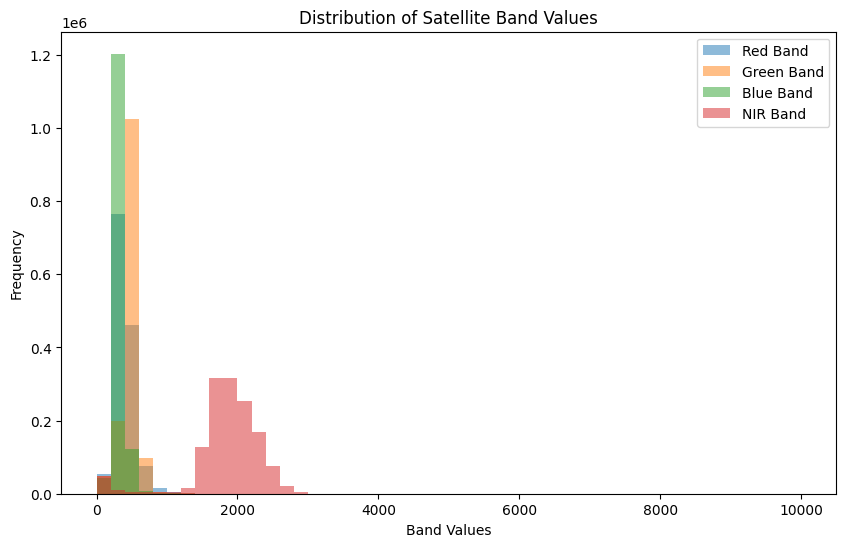

time: 2.32 s (started: 2023-07-01 12:37:03 +00:00)


In [9]:
train_data = ScarsDataset(dataset_dir, "train", trntransforms(), 1.)
red_band, green_band, blue_band, nir_band = np.array([]), np.array([]), np.array([]), np.array([])
for d in train_data.data['red']:
    red_band = np.append(red_band, d)
for d in train_data.data['green']:
    green_band = np.append(green_band, d)
for d in train_data.data['blue']:
    blue_band = np.append(blue_band, d)
for d in train_data.data['nir']:
    nir_band = np.append(nir_band, d)

# Generate random data for four satellite bands
band1_values = red_band*10000
band2_values = green_band*10000
band3_values = blue_band*10000
band4_values = nir_band*10000

# Create a figure with larger size
plt.figure(figsize=(10, 6))

# Plot the histograms for each band
min_range = 0
max_range = 10000
plt.hist(band1_values, bins=50, range=(min_range, max_range), alpha=0.5, label='Red Band')
plt.hist(band2_values, bins=50, range=(min_range, max_range), alpha=0.5, label='Green Band')
plt.hist(band3_values, bins=50, range=(min_range, max_range), alpha=0.5, label='Blue Band')
plt.hist(band4_values, bins=50, range=(min_range, max_range), alpha=0.5, label='NIR Band')

#plt.yscale('log')
# Add labels, titles, etc.
plt.xlabel('Band Values')
plt.ylabel('Frequency')
plt.title('Distribution of Satellite Band Values')
plt.legend()

# Display the plot
plt.show()

# Sample
Sample training data view after transformation is applied.

Taking 21/21 data files.


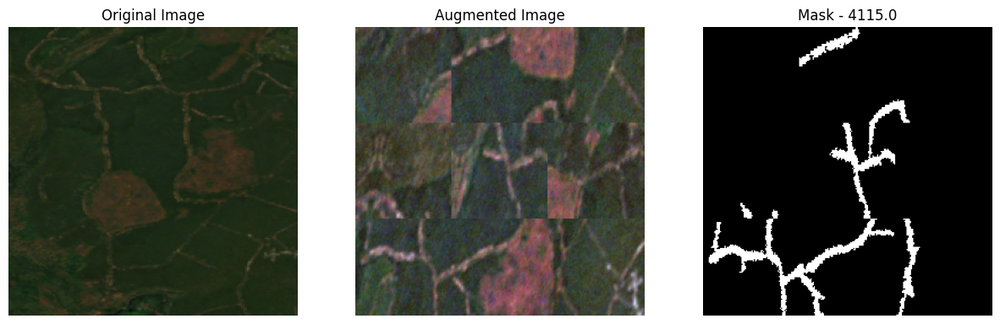

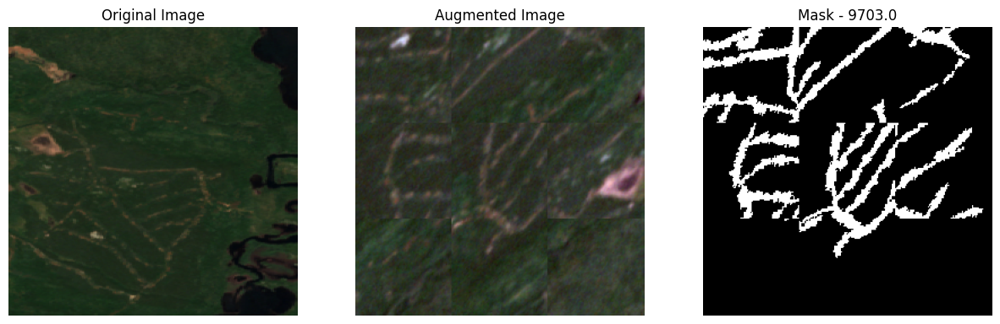

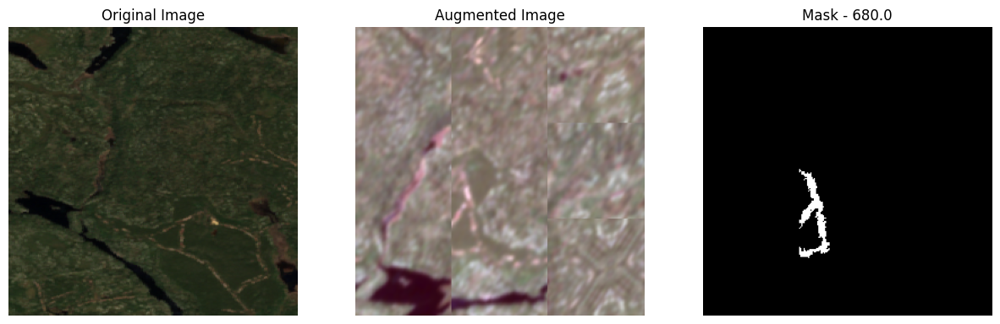

time: 3.86 s (started: 2023-07-01 12:37:05 +00:00)


In [10]:
train_data = ScarsDataset(dataset_dir, "train", trntransforms(), 1.0)
for i in range(3):
    x, y, x2, _, _ = train_data[i]
    x = x.numpy()
    y = y.numpy()
    x2 = np.dstack((x2[0,:,:], x2[1,:,:], x2[2,:,:]))
    x = (x - np.min(x)) / (np.max(x) - np.min(x))
    x = np.dstack((x[0,:,:], x[1,:,:], x[2,:,:]))
    fig, ax = plt.subplots(1, 3, figsize=(15, 6))
    ax[0].imshow(x2)
    ax[0].set_title("Original Image")
    ax[0].axis('off')

    ax[1].imshow(x)
    ax[1].set_title(f"Augmented Image")
    ax[1].axis('off')

    ax[2].imshow(y[0], cmap='gray')
    ax[2].set_title(f"Mask - {y[0].sum()}")
    ax[2].axis('off')
    plt.show()

# Model
Defining a U-Net model whic is a convolutional neural network.

In [11]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = smp.Unet(encoder_name='timm-efficientnet-b5', encoder_depth=5, encoder_weights='imagenet', decoder_use_batchnorm=True,
                 decoder_channels=(256, 128, 64, 32, 16), decoder_attention_type='scse', in_channels=4, classes=1,
                 activation=None, aux_params=None).to(device)

time: 7.51 s (started: 2023-07-01 12:37:09 +00:00)


# Loss
Defining a loss which is a combination of weighted binary cross entropy and Dice loss.

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CombinedLossV3(nn.Module):
    def __init__(self, weight=1.0, alpha=0.25, gamma=2., max_loss=10):
        super(CombinedLossV3, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.max_loss = max_loss
        self.beta = weight

    def forward(self, inputs, targets, smooth=1):
        # Flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)

        # Calculate weights for the BCE loss based on the targets
        beta = self.beta
        weights = beta * targets + (1 - beta) * (1 - targets)  # weights add up to 1

        # Weighted BCE Loss
        BCE = F.binary_cross_entropy_with_logits(inputs, targets, weight=weights, reduction='mean')

        # Focal Loss
        BCE_loss = F.binary_cross_entropy_with_logits(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss) # pt is the probability of the true class
        F_loss = self.alpha * (1-pt)**self.gamma * BCE_loss
        F_loss = F_loss.clamp(max=self.max_loss)  # maintaining numerical stability
        F_loss = torch.mean(F_loss)

        # Dice Loss
        inputs_soft = torch.sigmoid(inputs)
        intersection = (inputs_soft * targets).sum()
        dice = (2.*intersection + smooth)/(inputs_soft.sum() + targets.sum() + smooth)
        dice_loss = 1 - dice

        # Combined Loss
        combined_loss = BCE + F_loss + dice_loss
        return combined_loss

time: 1.92 ms (started: 2023-07-01 12:37:17 +00:00)


# Loading Dataset

Loading both the traning and validation dataset and an iterable around the dataset.

In [13]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Loading dataset
train_data = ScarsDataset(dataset_dir, "train", trntransforms(), 1.0)
valid_data = ScarsDataset(dataset_dir, "valid", tsttransforms(), 1.0)

train_loader = DataLoader(train_data, batch_size=21, shuffle=True)
valid_loader = DataLoader(valid_data, batch_size=6, shuffle=True)

Taking 21/21 data files.
/content/data_256/valid/image/scars_caribou-lake-702_1.tif file has 1024 NaN values.
Taking 6/6 data files.
time: 512 ms (started: 2023-07-01 12:37:17 +00:00)


# Training Setup
Training preparation by instantiating the model, defining a loss, an optimizer, a scheduler and etc.

In [14]:
epochs = 200
total_steps = len(train_loader)
n_warmup_epochs = 20

# Define the loss function and optimizer
criterion = CombinedLossV3(train_data.pos_weight)
optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=0.1)

scheduler = CosineLRScheduler(
            optimizer,
            t_initial= total_steps * epochs + 1,
            lr_min=0.0001,
            warmup_lr_init=0.0001,
            warmup_t= total_steps * n_warmup_epochs + 1)

time: 20.6 ms (started: 2023-07-01 12:37:17 +00:00)


# Training Loop
Defining and running the training loop

In [15]:
def dice_coeff(pred, target, smooth=1):
    pred = pred.contiguous()
    target = target.contiguous()

    intersection = (pred * target).sum(dim=2).sum(dim=2)

    dice = (2. * intersection + smooth) / (pred.sum(dim=2).sum(dim=2) + target.sum(dim=2).sum(dim=2) + smooth)

    return dice.mean()

def iou(pred, target, smooth=1):
    pred = pred.contiguous()
    target = target.contiguous()

    intersection = (pred * target).sum(dim=2).sum(dim=2)
    total = (pred + target).sum(dim=2).sum(dim=2)

    iou = (intersection + smooth) / (total - intersection + smooth)

    return iou.mean()

time: 1.02 ms (started: 2023-07-01 12:37:17 +00:00)


In [16]:
class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement.
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = float('inf')
        self.delta = delta
        self.best_pt = ''

    def __call__(self, val_loss, model, pt_path):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model, pt_path)
        elif score < self.best_score + self.delta:
            self.counter += 1
            print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model, pt_path)
            self.counter = 0

    def save_checkpoint(self, val_loss, model, pt_path):
        '''Saves model when validation loss decreases.'''
        if self.verbose:
            print(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model, pt_path)  # save checkpoint
        self.val_loss_min = val_loss
        self.best_pt = pt_path

time: 1.35 ms (started: 2023-07-01 12:37:17 +00:00)


In [17]:
early_stopping = EarlyStopping(patience=10, verbose=True)

def binarize_output(output, threshold=0.5):
    return (output > threshold).float()

def train_model(model_path, model, optimizer, scheduler, num_epochs):
  !rm -rf {model_path}
  !mkdir -p {model_path}
  step_counter_train, step_counter_val = 0, 0
  since = time.time()
  iteration = 0
  best_f1 = 0.0
  for epoch in range(num_epochs):
      print('Epoch {}/{}'.format(epoch+1, num_epochs))
      model.train()
      total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
      for step, batch in enumerate(train_loader):
          x = batch[0].to(device)
          y = batch[1].to(device)

          optimizer.zero_grad()
          outputs = model(x)
          # Partial loss against original labels, partial loss against mixed up labels
          loss = criterion(outputs, y)

          loss.backward()
          optimizer.step()
          scheduler.step(iteration)
          iteration += 1

          # Calculate metrics.
          outputs_prob = torch.sigmoid(outputs)
          train_iou = iou(outputs_prob, y).item()
          train_dice = dice_coeff(outputs_prob, y).item()
          train_loss = loss.item()
          total_loss += train_loss
          total_dice += train_dice
          total_iou += train_iou

          writer.add_scalar('Loss/Train', train_loss, step_counter_train)
          writer.add_scalar('IoU/Train', train_iou, step_counter_train)
          writer.add_scalar('Dice/Train', train_dice, step_counter_train)
          step_counter_train += 1
          # Log the images
          if step % 20 == 0:  # Only log every 10 batches
              original_grid = make_grid(batch[2][0][:3,:,:])
              input_grid = batch[0][0]
              for i in range(input_grid.shape[0]):
                  input_grid[i] = (input_grid[i] - input_grid[i].min()) / (input_grid[i].max() - input_grid[i].min())
              input_grid = make_grid(input_grid[:3, :, :])
              output_grid = make_grid(binarize_output(outputs.detach()[0]))
              label_grid = make_grid(batch[1][0])
              writer.add_image('Input/Train', input_grid, epoch * len(train_loader) + step)
              writer.add_image('Output/Train', output_grid, epoch * len(train_loader) + step)
              writer.add_image('Label/Train', label_grid, epoch * len(train_loader) + step)
              writer.add_image('Original/Train', original_grid, epoch * len(train_loader) + step)
      avg_loss = total_loss / len(train_loader)
      avg_dice = total_dice / len(train_loader)
      avg_iou = total_iou / len(train_loader)
      writer.add_scalar('Epoch_Loss/Train', avg_loss, epoch)
      writer.add_scalar('Epoch_IoU/Train', avg_iou, epoch)
      writer.add_scalar('Epoch_Dice/Train', avg_dice, epoch)

      model.eval()
      total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
      for step, batch in enumerate(valid_loader):
          x = batch[0].to(device)
          y = batch[1].to(device)
          with torch.no_grad():
              outputs = model(x)
              loss = criterion(outputs, y)

          # Calculate metrics.
          outputs_prob = torch.sigmoid(outputs)
          val_iou = iou(outputs_prob, y).item()
          val_dice = dice_coeff(outputs_prob, y).item()
          val_loss = loss.item()
          total_loss += val_loss
          total_dice += val_dice
          total_iou += val_iou

          writer.add_scalar('Loss/Validate', val_loss, step_counter_val)
          writer.add_scalar('IoU/Validate', val_iou, step_counter_val)
          writer.add_scalar('Dice/Validate', val_dice, step_counter_val)
          step_counter_val += 1

          # Log the images
          if step % 5 == 0:  # Only log every 10 batches
              original_grid = make_grid(batch[2][0][:3,:,:])
              input_grid = batch[0][0]
              for i in range(input_grid.shape[0]):
                  input_grid[i] = (input_grid[i] - input_grid[i].min()) / (input_grid[i].max() - input_grid[i].min())
              input_grid = make_grid(input_grid[:3, :, :])
              output_grid = make_grid(binarize_output(outputs.detach()[0]))
              label_grid = make_grid(batch[1][0])
              writer.add_image('Input/Validate', input_grid, epoch * len(valid_loader) + step)
              writer.add_image('Output/Validate', output_grid, epoch * len(valid_loader) + step)
              writer.add_image('Label/Validate', label_grid, epoch * len(valid_loader) + step)
              writer.add_image('Original/Validate', original_grid, epoch * len(valid_loader) + step)
      avg_loss = total_loss / len(valid_loader)
      avg_dice = total_dice / len(valid_loader)
      avg_iou = total_iou / len(valid_loader)
      writer.add_scalar('Epoch_Loss/Validate', avg_loss, epoch)
      writer.add_scalar('Epoch_IoU/Validate', avg_iou, epoch)
      writer.add_scalar('Epoch_Dice/Validate', avg_dice, epoch)
      print(f"Avg Loss = {avg_loss:.5f}, Avg IoU = {avg_iou:.5f}, Avg Dice = {avg_dice:.5F}")

      # Early_stopping needs the validation loss to check if it has decreased,
      # and if it has, it will save the current model checkpoint
      pt_path = model_path+f"model_epoch_{epoch}_dice_{avg_dice:.5f}_iou_{avg_iou:.5f}.pt"
      early_stopping(avg_loss, model, pt_path)

      if early_stopping.early_stop:
          print("Early stopping")
          break

time: 10.2 ms (started: 2023-07-01 12:37:17 +00:00)


In [18]:
%tensorboard --logdir=/data/runs

<IPython.core.display.Javascript object>

time: 10.5 s (started: 2023-07-01 12:37:17 +00:00)


In [19]:
model_path = "/content/drive/MyDrive/GreenGuardians_models/scars/unet_D256_L1.25X_P0.5_LossV3_weight_3/"
train_model(model_path, model, optimizer, scheduler, epochs)

Epoch 1/200
Avg Loss = 1.11085, Avg IoU = 0.04860, Avg Dice = 0.09170
Validation loss decreased (inf --> 1.110849).  Saving model ...
Epoch 2/200
Avg Loss = 1.06419, Avg IoU = 0.04977, Avg Dice = 0.09378
Validation loss decreased (1.110849 --> 1.064188).  Saving model ...
Epoch 3/200
Avg Loss = 1.04466, Avg IoU = 0.05091, Avg Dice = 0.09582
Validation loss decreased (1.064188 --> 1.044660).  Saving model ...
Epoch 4/200
Avg Loss = 1.03312, Avg IoU = 0.05198, Avg Dice = 0.09771
Validation loss decreased (1.044660 --> 1.033123).  Saving model ...
Epoch 5/200
Avg Loss = 1.02498, Avg IoU = 0.05299, Avg Dice = 0.09951
Validation loss decreased (1.033123 --> 1.024981).  Saving model ...
Epoch 6/200
Avg Loss = 1.01905, Avg IoU = 0.05409, Avg Dice = 0.10147
Validation loss decreased (1.024981 --> 1.019052).  Saving model ...
Epoch 7/200
Avg Loss = 1.01535, Avg IoU = 0.05530, Avg Dice = 0.10360
Validation loss decreased (1.019052 --> 1.015351).  Saving model ...
Epoch 8/200
Avg Loss = 1.01381, 

# Model Output in Action
Model output view on valiation dataset.

/content/data_256/valid/image/scars_caribou-lake-702_1.tif file has 1024 NaN values.
Taking 6/6 data files.


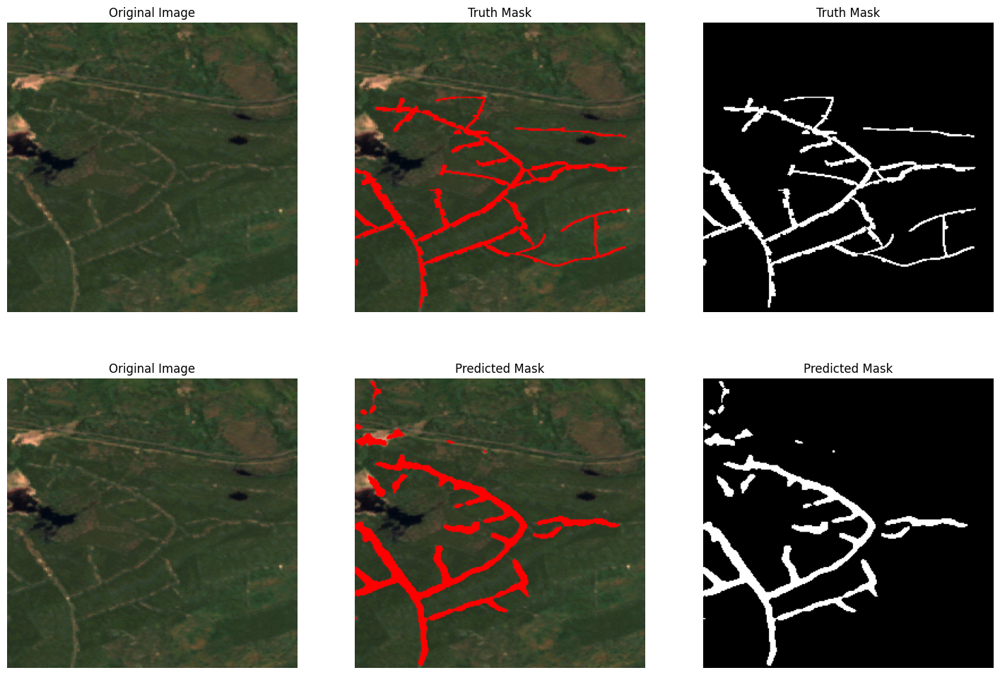

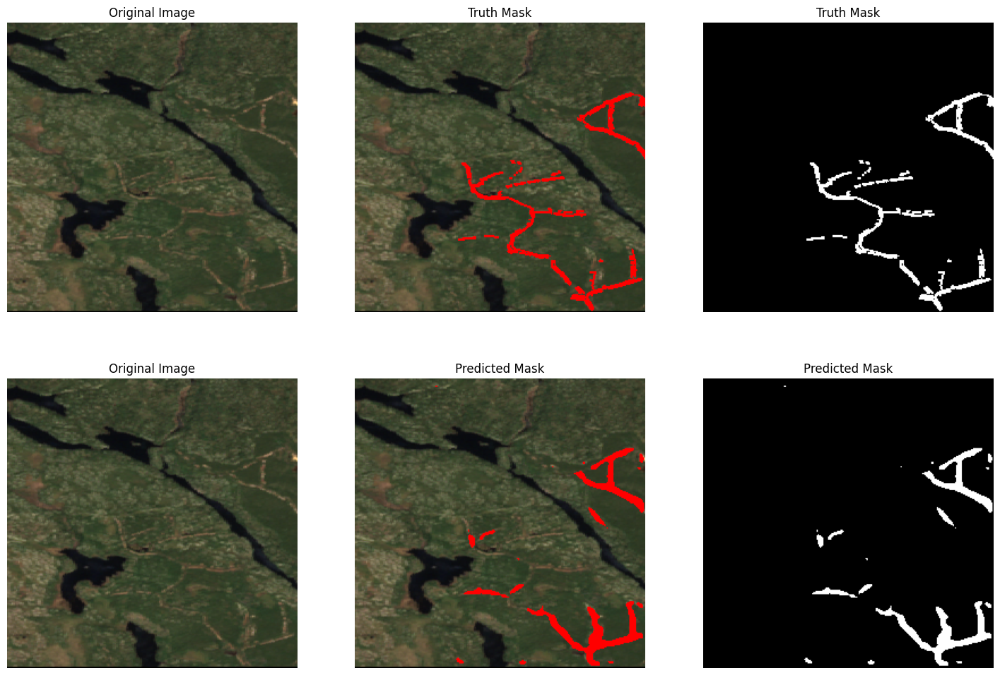

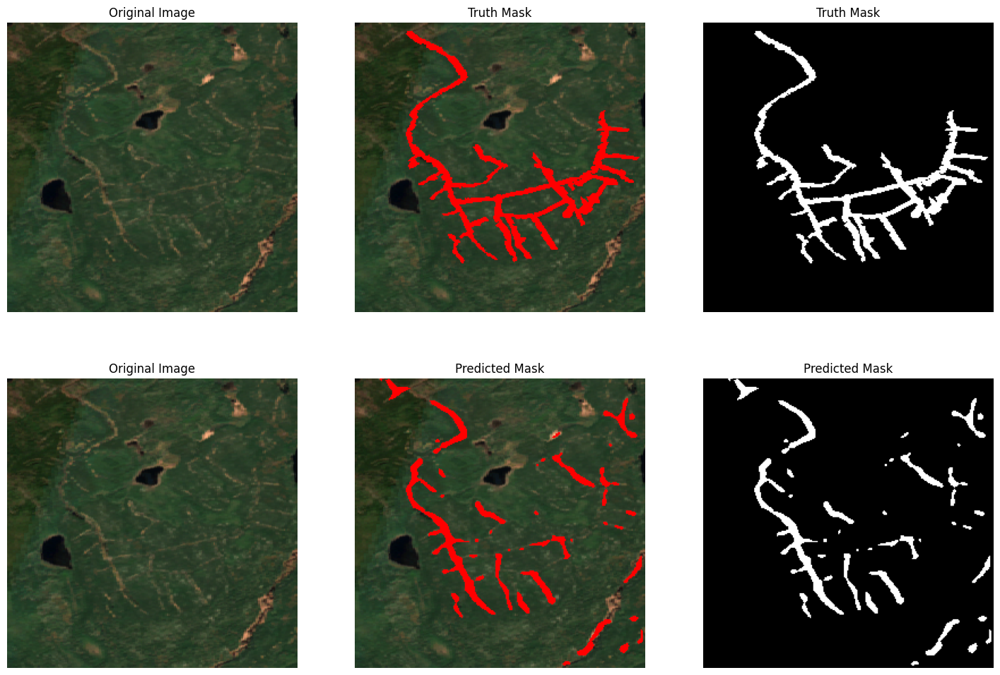

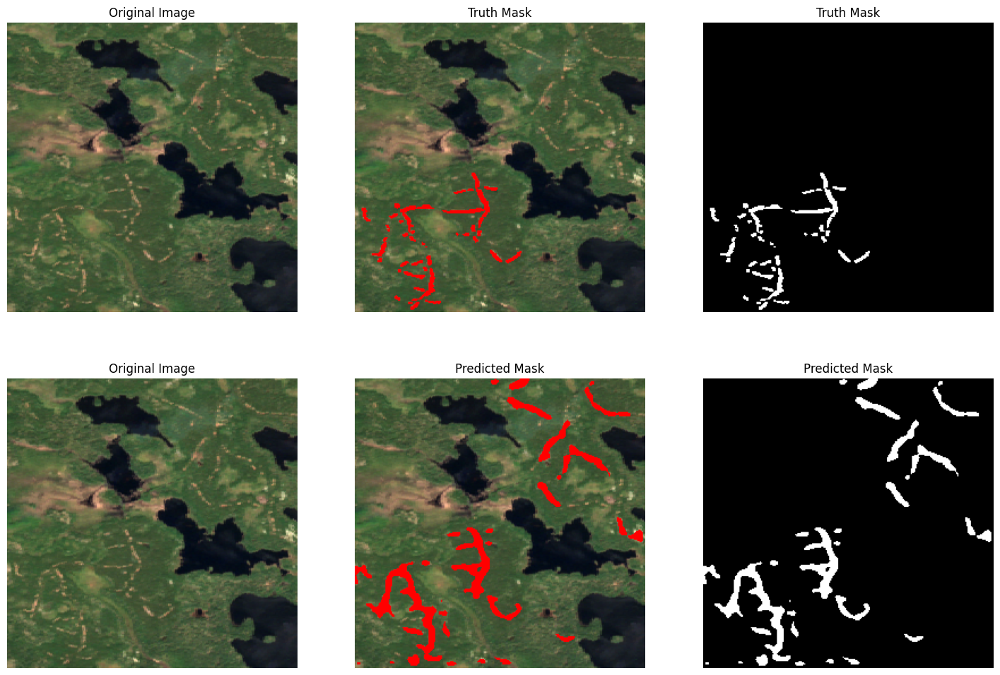

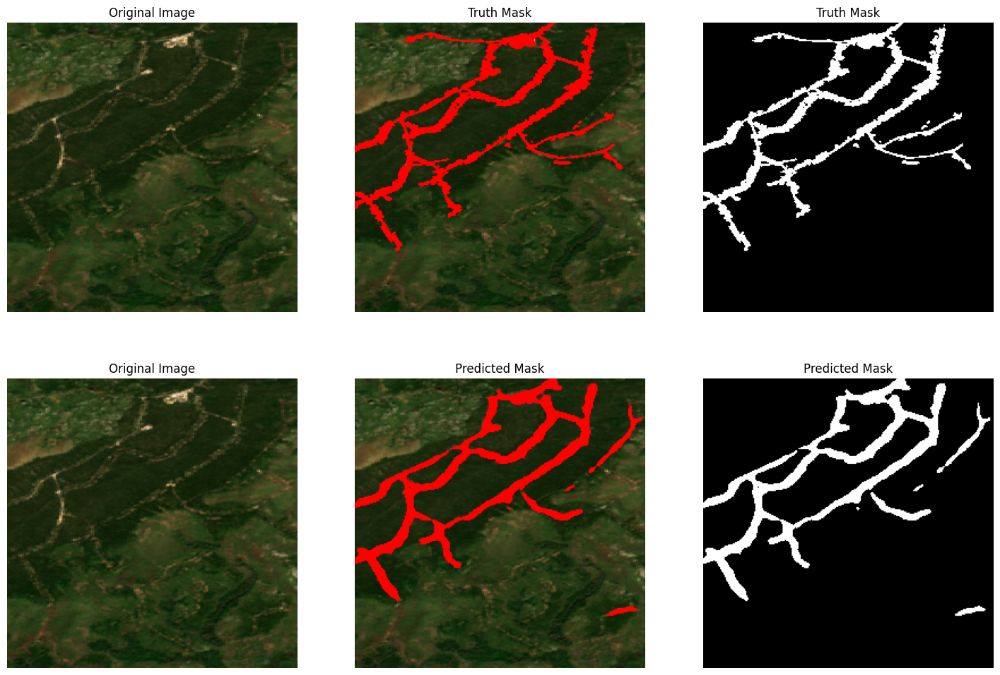

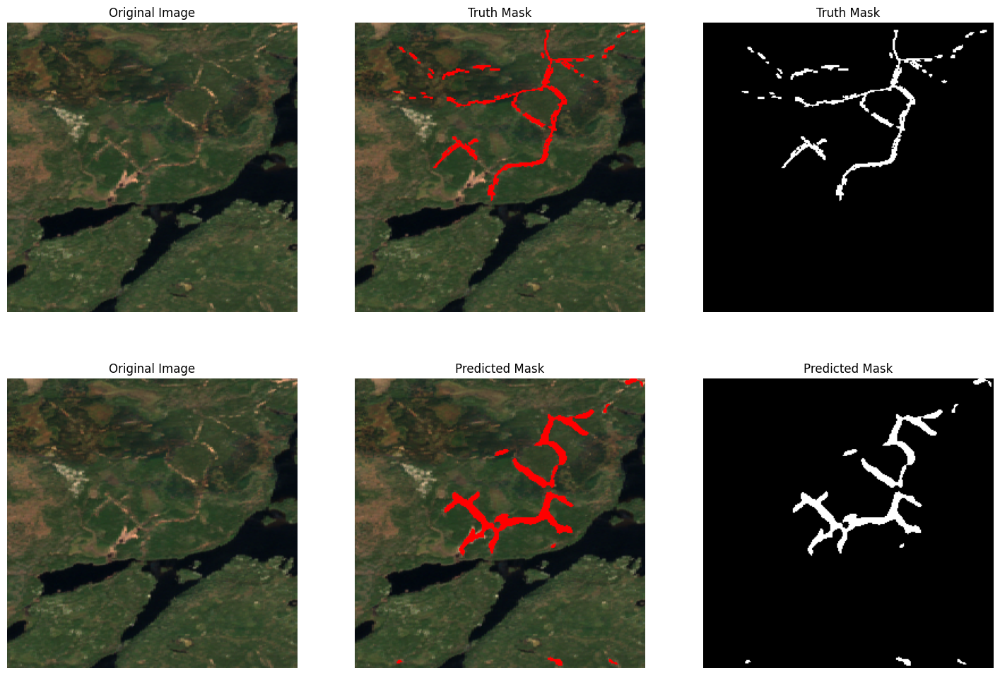

time: 7.42 s (started: 2023-07-01 12:44:30 +00:00)


In [20]:
#model_path = "/content/drive/MyDrive/GreenGuardians_models/scars/unet_D256_L1.25X_P0.5_LossV3_weight_3/"
#model = torch.load(model_path+f"model_epoch_9_dice_0.12446_iou_0.06760.pt")
model = torch.load(early_stopping.best_pt)

trans = tsttransforms()

t_data = ScarsDataset(dataset_dir, "valid", tsttransforms(), 1.0)
t_loader = DataLoader(t_data, batch_size=1, shuffle=True)

model.eval()
for i, (images, target, _, i_f, m_f) in enumerate(t_loader):
    images = images.to(device)
    label_mask = target.numpy()[0][0]
    label_mask = label_mask.astype('float32')

    f = i_f[0]
    with torch.no_grad():
        outputs = model(images)

    predict_mask = outputs[0][0]
    predict_mask = torch.sigmoid(predict_mask)
    predict_mask = torch.round(predict_mask)
    predict_mask = predict_mask.cpu().detach().numpy()

    fig, ax = plt.subplots(2, 3, figsize=(18, 12))
    [img, xsize, ysize, nbands] = loadTiff(f, 2000)
    img = trans(image=img)['image']
    img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2])).astype(np.float32)
    img_rgb = (img_rgb - np.min(img_rgb)) / (np.max(img_rgb) - np.min(img_rgb))

    # Create a red color overlay using the predict mask
    predict_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    predict_overlay[..., 0] = 1  # Red channel
    predict_overlay[..., 3] = predict_mask

    # Create a red color overlay using the labeled mask
    label_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    label_overlay[..., 0] = 1  # Red channel
    label_overlay[..., 3] = label_mask

    # Display the original image and the ground truth masked image
    ax[0,0].imshow(img_rgb)
    ax[0,0].set_title('Original Image')
    ax[0,0].axis('off')

    ax[0,1].imshow(img_rgb)
    ax[0,1].imshow(label_overlay)
    ax[0,1].set_title('Truth Mask')
    ax[0,1].axis('off')

    ax[0,2].imshow(label_mask, cmap='gray')
    ax[0,2].set_title('Truth Mask')
    ax[0,2].axis('off')

    # Display the original image and the predicted masked image
    ax[1,0].imshow(img_rgb)
    ax[1,0].set_title('Original Image')
    ax[1,0].axis('off')

    ax[1,1].imshow(img_rgb)
    ax[1,1].imshow(predict_overlay)
    ax[1,1].set_title('Predicted Mask')
    ax[1,1].axis('off')

    ax[1,2].imshow(predict_mask, cmap='gray')
    ax[1,2].set_title('Predicted Mask')
    ax[1,2].axis('off')

    plt.show()

Model output view on train dataset.

Taking 21/21 data files.


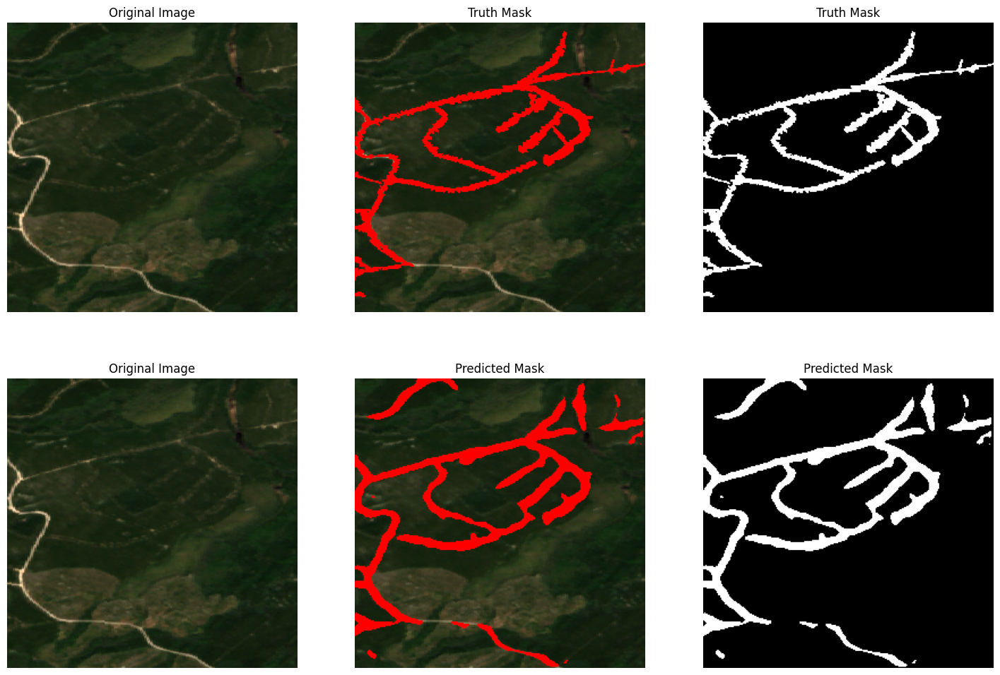

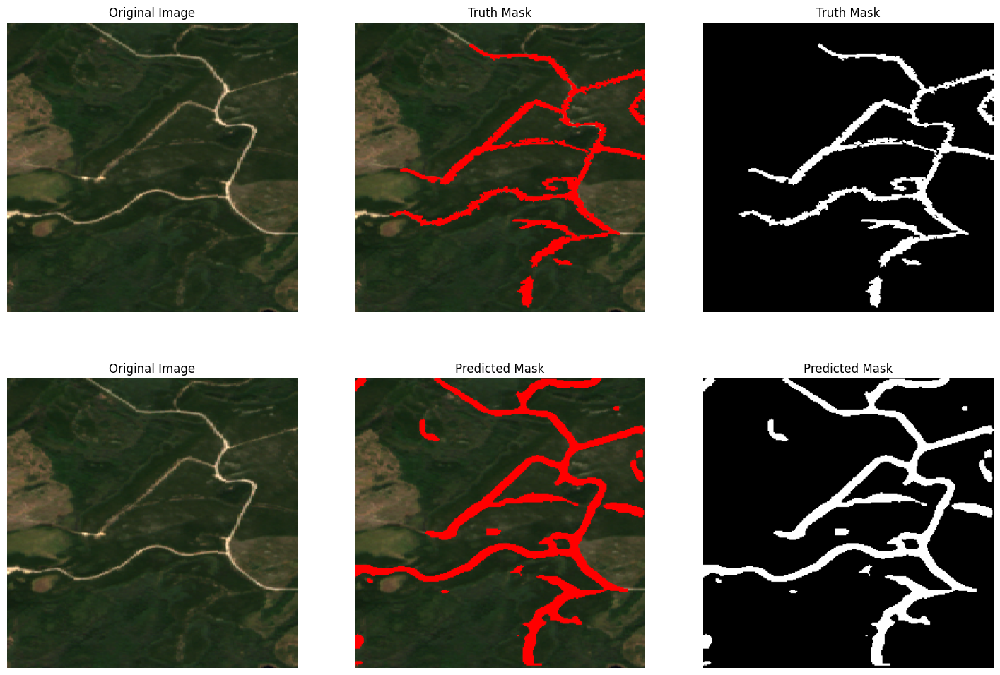

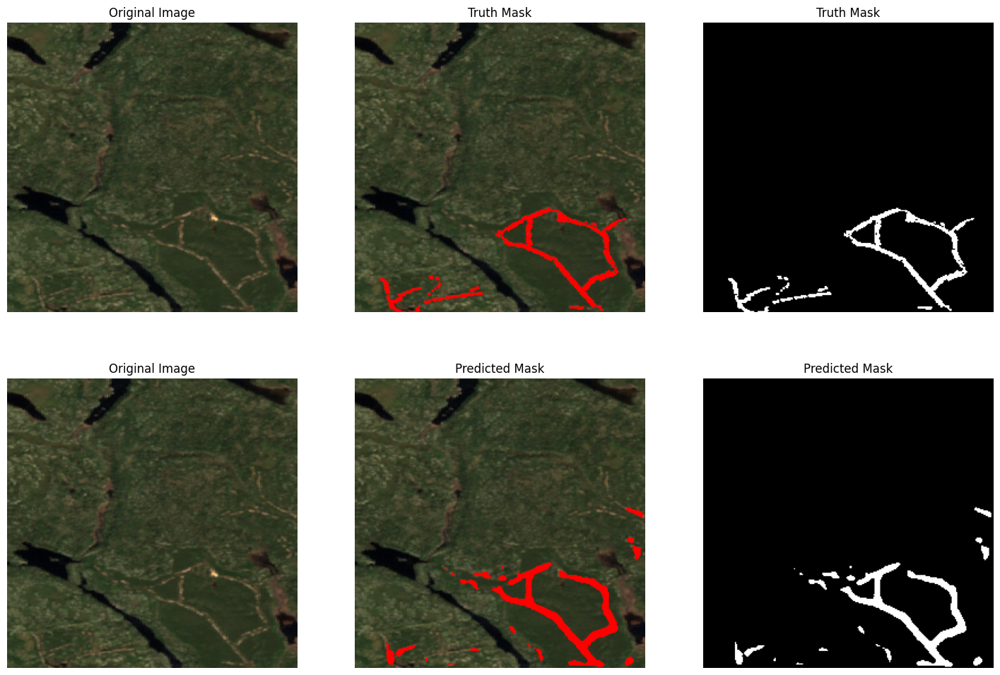

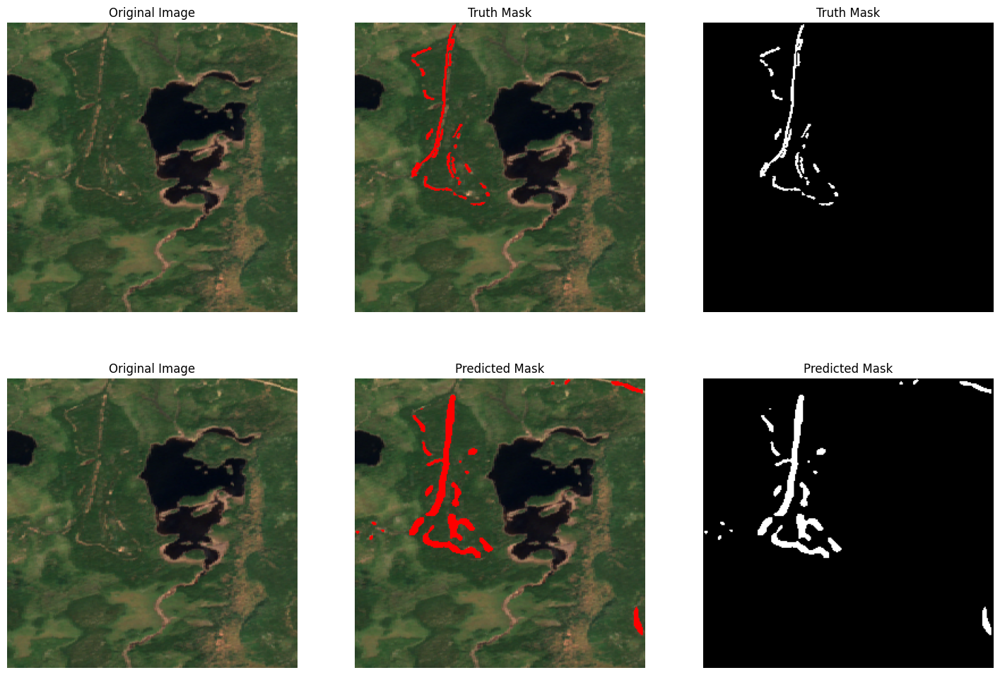

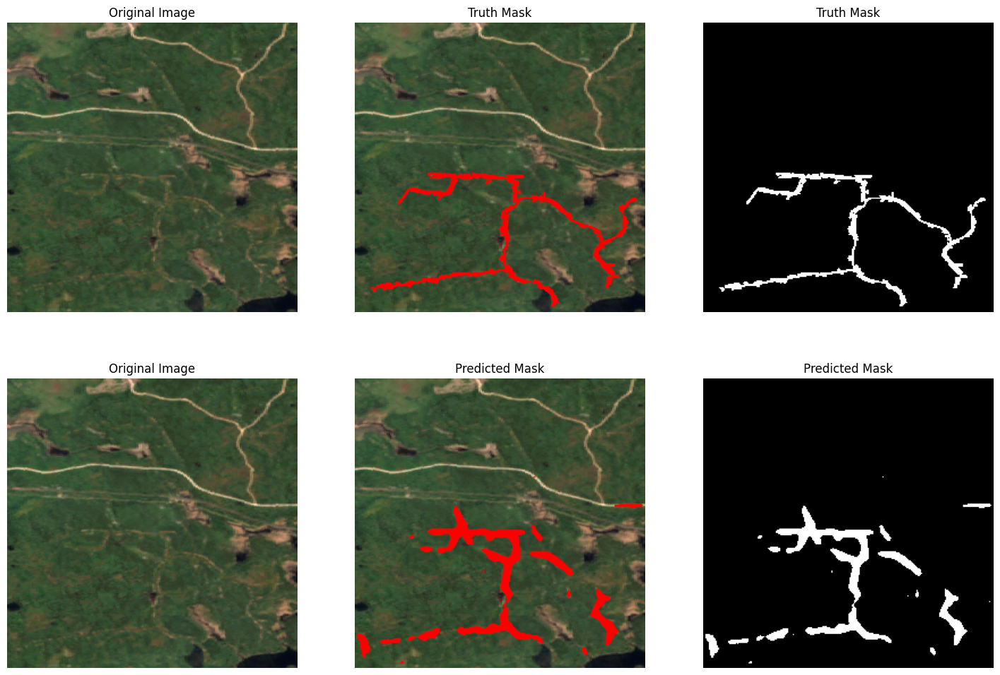

...

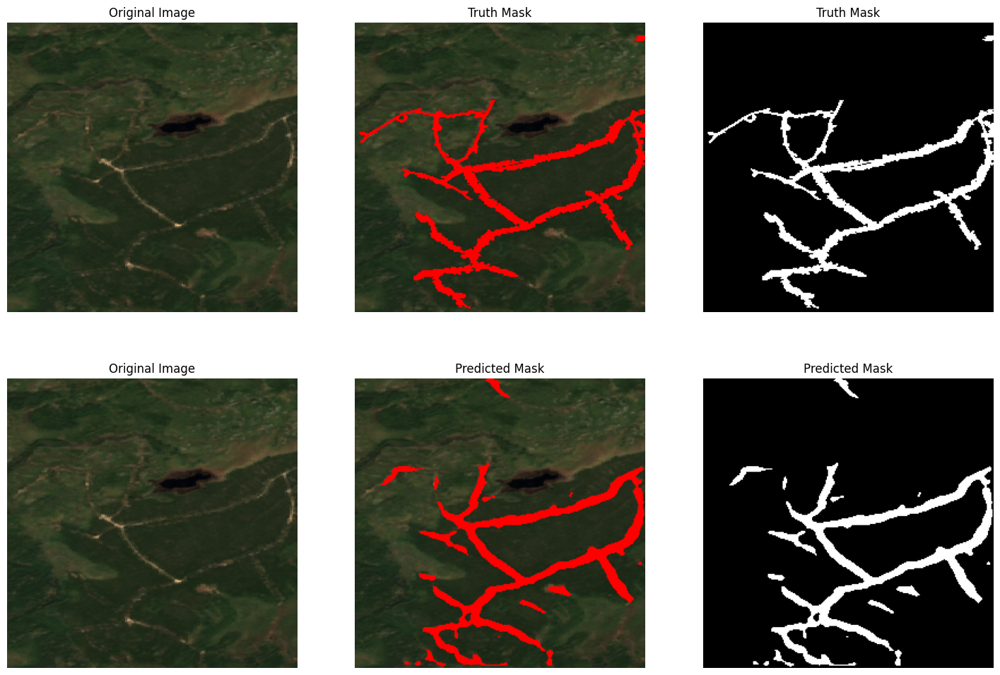

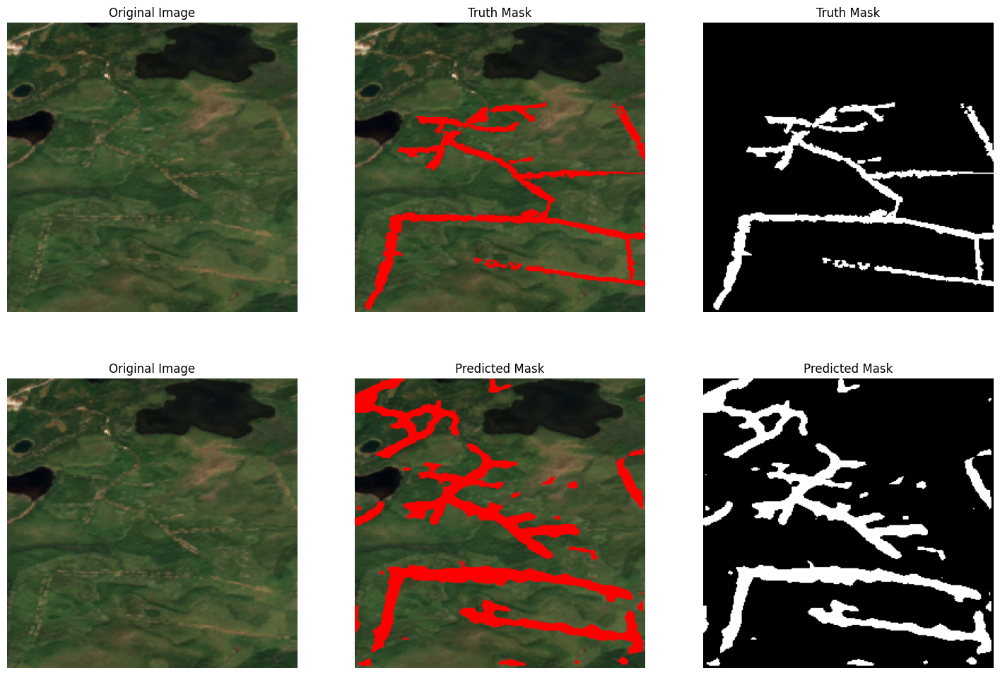

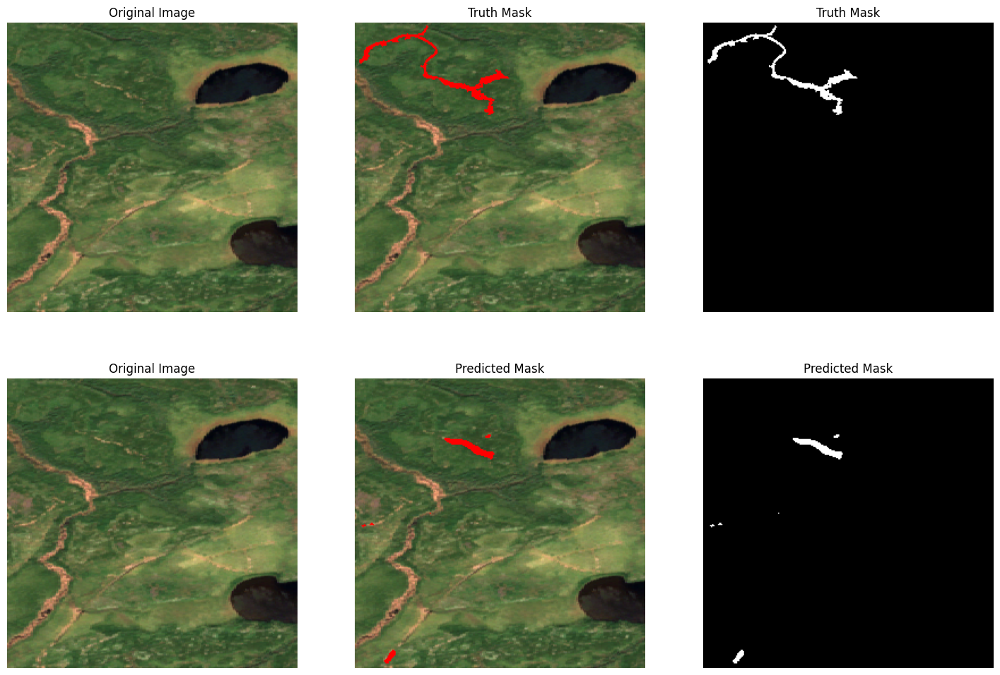

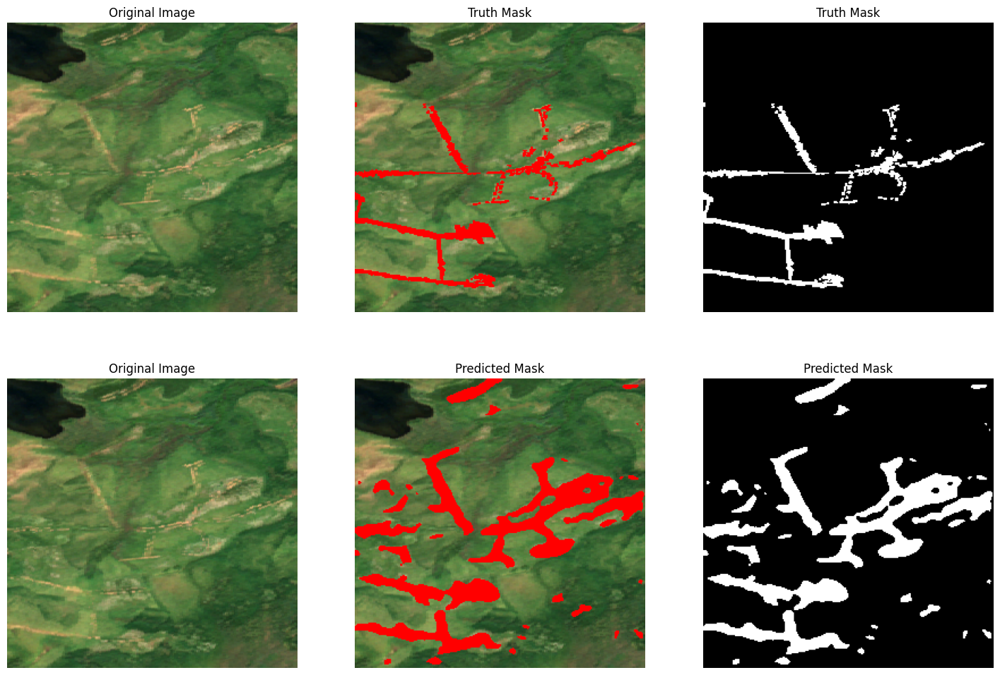

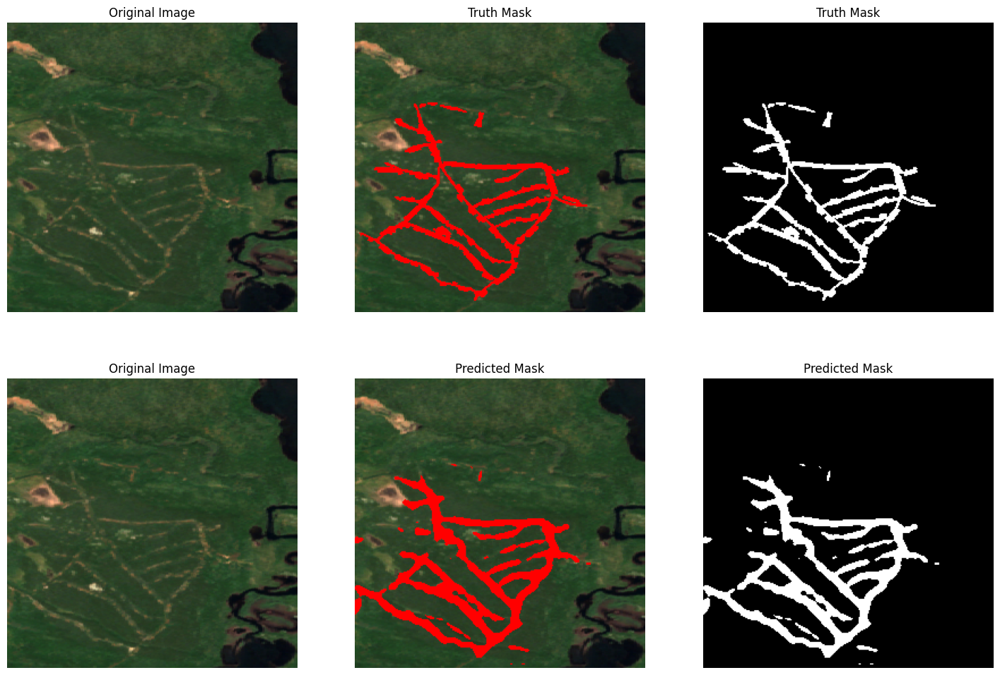

time: 33.9 s (started: 2023-07-01 12:44:38 +00:00)


In [21]:
t_data = ScarsDataset(dataset_dir, "train", tsttransforms(), 1.0)
t_loader = DataLoader(t_data, batch_size=1, shuffle=True)

model.eval()
for i, (images, target, _, i_f, m_f) in enumerate(t_loader):
    images = images.to(device)
    label_mask = target.numpy()[0][0]
    label_mask = label_mask.astype('float32')

    f = i_f[0]
    with torch.no_grad():
        outputs = model(images)

    predict_mask = outputs[0][0]
    predict_mask = torch.sigmoid(predict_mask)
    predict_mask = torch.round(predict_mask)
    predict_mask = predict_mask.cpu().detach().numpy()

    fig, ax = plt.subplots(2, 3, figsize=(18, 12))
    [img, xsize, ysize, nbands] = loadTiff(f, 2000)
    img = trans(image=img)['image']
    img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2])).astype(np.float32)
    img_rgb = (img_rgb - np.min(img_rgb)) / (np.max(img_rgb) - np.min(img_rgb))

    # Create a red color overlay using the predict mask
    predict_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    predict_overlay[..., 0] = 1  # Red channel
    predict_overlay[..., 3] = predict_mask

    # Create a red color overlay using the labeled mask
    label_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
    label_overlay[..., 0] = 1  # Red channel
    label_overlay[..., 3] = label_mask

    # Display the original image and the ground truth masked image
    ax[0,0].imshow(img_rgb)
    ax[0,0].set_title('Original Image')
    ax[0,0].axis('off')

    ax[0,1].imshow(img_rgb)
    ax[0,1].imshow(label_overlay)
    ax[0,1].set_title('Truth Mask')
    ax[0,1].axis('off')

    ax[0,2].imshow(label_mask, cmap='gray')
    ax[0,2].set_title('Truth Mask')
    ax[0,2].axis('off')

    # Display the original image and the predicted masked image
    ax[1,0].imshow(img_rgb)
    ax[1,0].set_title('Original Image')
    ax[1,0].axis('off')

    ax[1,1].imshow(img_rgb)
    ax[1,1].imshow(predict_overlay)
    ax[1,1].set_title('Predicted Mask')
    ax[1,1].axis('off')

    ax[1,2].imshow(predict_mask, cmap='gray')
    ax[1,2].set_title('Predicted Mask')
    ax[1,2].axis('off')

    plt.show()

time: 33.9 s (started: 2023-07-01 12:44:38 +00:00)
